# COVET on Spatial Pancreas data  S1

Perform analysis per donor, consider one object per slide (2 donors) and perform analysis per fov.  

**in v6**: extend to all fovs in s1 and aggregate results by donor, def

**conclusion**:

### Pre-requisites

In [1]:
import os

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0" # Change to -1 if you want to use CPU!

import warnings
warnings.filterwarnings('ignore')

In [2]:
import scenvi

In [3]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
import scanpy as sc
#import colorcet
import sklearn.neighbors
import scipy.sparse
import umap.umap_ as umap
import squidpy as sq

In [4]:
from tqdm import tqdm
from anndata import AnnData
from matplotlib.axes import Axes

In [ ]:
!pip install squidpy

### Data

In [5]:
folder = '/lustre/groups/ml01/workspace/sara.jimenez/spatial_pancreas_data/preprocessed_data/data4downstream/'
file   = 'S1_npod_annotation_filtered.h5ad'

adata = sc.read_h5ad(folder+file)
adata

AnnData object with n_obs × n_vars = 108711 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'CellTypes_max'
    uns: 'CellTypes_max_colors', 'cell_type_coarse_colors', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_fov'
    layers: 'counts'

In [8]:
# Combine 'slide' and 'condition' into a new 'donor' field
adata.obs['donor'] = adata.obs['slide'].str.cat(adata.obs['condition'], sep="_")

adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_genes,cell_type_coarse,CellTypes_max,donor
1_1,1,3038,2.05,-25945.777778,122127.000000,88,43,1830,13181,74,...,100.000000,100.0,100.0,1,0.693147,0.418410,97,Acinar,Acinar_signal,Run5211_S1_T1D
2_1,1,2507,1.34,-25566.777778,122125.000000,63,47,902,5621,82,...,100.000000,100.0,100.0,1,0.693147,0.581395,73,Acinar,Acinar_basal,Run5211_S1_T1D
3_1,1,7970,1.53,-25278.777778,122102.000000,142,93,1476,7846,134,...,82.862191,100.0,100.0,3,1.386294,0.530035,197,Acinar,Endothelial,Run5211_S1_T1D
4_1,1,5041,1.80,-24148.777778,122116.000000,115,64,931,7451,161,...,87.500000,100.0,100.0,2,1.098612,0.595238,142,Acinar,Acinar_highEnz,Run5211_S1_T1D
5_1,1,3835,1.17,-24070.777778,122108.000000,95,81,1016,7478,152,...,88.073394,100.0,100.0,0,0.000000,0.000000,139,Acinar,Acinar_highEnz,Run5211_S1_T1D
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4724_24,24,1666,1.02,26190.222222,139474.888889,48,47,431,1514,95,...,100.000000,100.0,100.0,0,0.000000,0.000000,22,Fibroblasts,Acinar_sigdiff,Run5211_S1_ND
4725_24,24,2624,1.35,29172.222222,139465.888889,69,51,688,7950,77,...,100.000000,100.0,100.0,0,0.000000,0.000000,16,Acinar,Delta,Run5211_S1_ND
4726_24,24,2473,1.04,27394.222222,139466.888889,56,54,408,2139,156,...,100.000000,100.0,100.0,0,0.000000,0.000000,52,Acinar,Acinar_signal,Run5211_S1_ND
4727_24,24,1821,1.33,24815.222222,139460.888889,56,42,223,1113,77,...,100.000000,100.0,100.0,0,0.000000,0.000000,11,Acinar,Acinar_basal,Run5211_S1_ND


In [6]:
adata.layers['counts'].max(), adata.X.max()

(285, 4.715945)

### Subsetting and pre-processing

COVET requires un-logged counts and it doesn't work with adata.X sparse 

In [9]:
adata.X = adata.layers['counts'].toarray()
print(adata.X.max())
sc.pp.normalize_total(adata)
print(adata.X.max())
adata.obs['cell_type'] = adata.obs['CellTypes_max']

285
110.71429


### Compute covet

#### Covet with different neighbors  

Important to compute the covet representation per slide per condition. Unable to deal with the batch effect generated from multiple conditions

In [10]:
NEIGHBORS = [8, 15, 30]

In [11]:
import anndata as ad

adatas_fov = []
for c in adata.obs.fov.cat.categories:
        
    adata_fov = adata[np.isin(adata.obs['fov'],[c])].copy()
             
    for n_neighbors in NEIGHBORS:
        (
            adata_fov.obsm[f"covet-n_neighbors={n_neighbors}"],
            adata_fov.obsm[f"covet_sqrt-n_neighbors={n_neighbors}"],
            adata_fov.uns[f"covet_genes-n_neighbors={n_neighbors}"],
        ) = scenvi.utils.compute_covet(adata_fov, k=n_neighbors, g=64, genes=[], spatial_key='spatial')#, batch_key='fov')
            
    adatas_fov.append(adata_fov)       
    del adata_fov
        
adata = ad.concat(adatas_fov, join='outer',uns_merge='same',axis=0)

**Note:** new in v4: instead of doing the analysis per condition do it per fov 

In [12]:
adatas_fov = []
for c in adata.obs.fov.cat.categories:
    adata_fov = adata[np.isin(adata.obs['fov'],[c])].copy()
    for n_neighbors in NEIGHBORS:
        adata_fov.obsm[f"covet_sqrt_flat-n_neighbors={n_neighbors}"] = np.reshape(
            adata_fov.obsm[f"covet_sqrt-n_neighbors={n_neighbors}"],[adata_fov.shape[0], -1]
        )
    adatas_fov.append(adata_fov)       
    del adata_fov
adata = ad.concat(adatas_fov, join='outer',uns_merge='same',axis=0)

### COVET analysis

In [ ]:
folder

In [ ]:
adata.write(folder+'s1_covet_rep_per_fov.h5ad')

In [ ]:
adata_cond = adata[np.isin(adata.obs['fov'],['12'])].copy()

In [ ]:
for n_neighbors in NEIGHBORS:
    sc.pp.neighbors(adata_cond, use_rep=f"covet_sqrt_flat-n_neighbors={n_neighbors}",
                    key_added=f"n_neighbors={n_neighbors}")

In [15]:
adatas_fov = []
for c in adata.obs.fov.cat.categories:
    adata_fov = adata[np.isin(adata.obs['fov'],[c])].copy()
    print(c)                   
    sc.pp.neighbors(adata_fov, use_rep=f"covet_sqrt_flat-n_neighbors={30}",
                    key_added=f"n_neighbors={30}")
    adatas_fov.append(adata_fov)       
    del adata_fov
    
adata = ad.concat(adatas_fov, join='outer',uns_merge='same',axis=0,pairwise=True)        

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24


In [16]:
adata

AnnData object with n_obs × n_vars = 108711 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'CellTypes_max', 'donor', 'cell_type'
    uns: 'CellTypes_max_colors', 'neighbors', 'pca', 'spatial', 'umap', 'hvg', 'n_neighbors=30'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_fov', 'covet-n_neighbors=8', 'covet_sqrt-n_neighbors=8', 'covet-n_neighbors=15', 'covet_sqrt-n_neighbors=15', 'covet-n_neighbors=30', 'covet_sqrt-n_neighbors=30', 'covet_sqrt_flat-

1


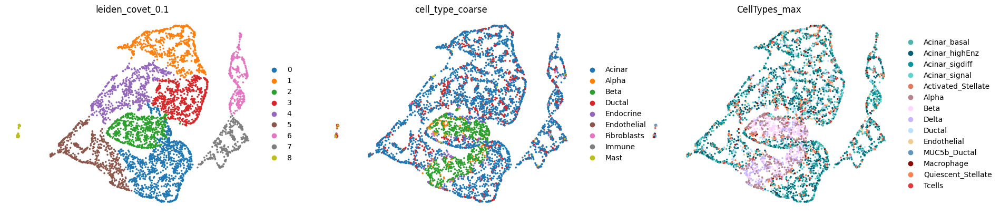

2


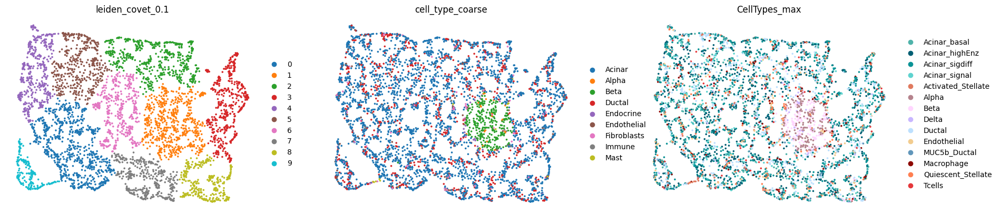

3


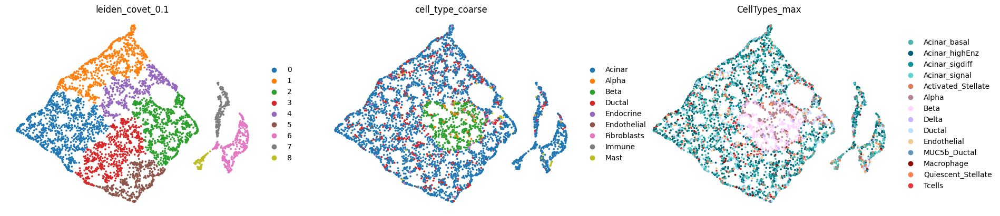

4


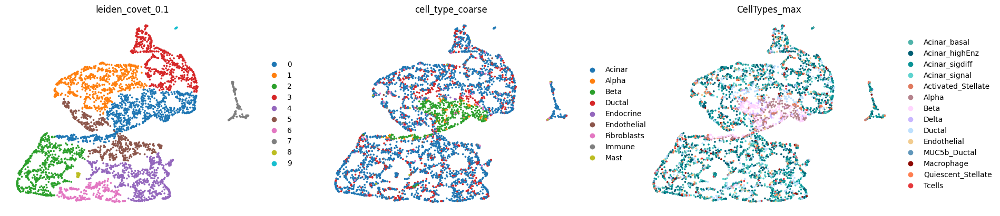

5


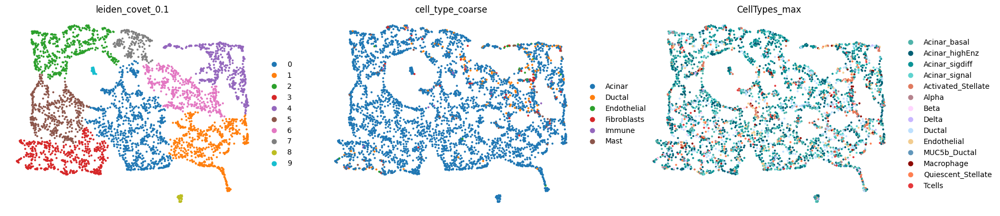

6


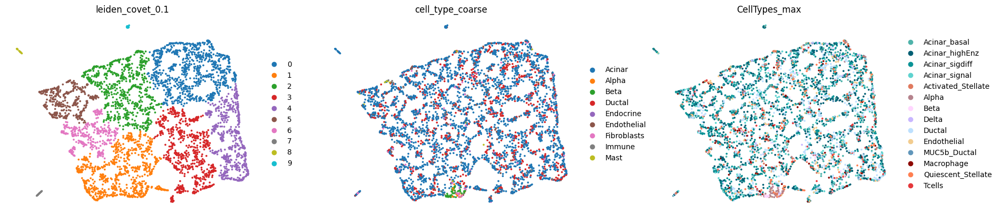

7


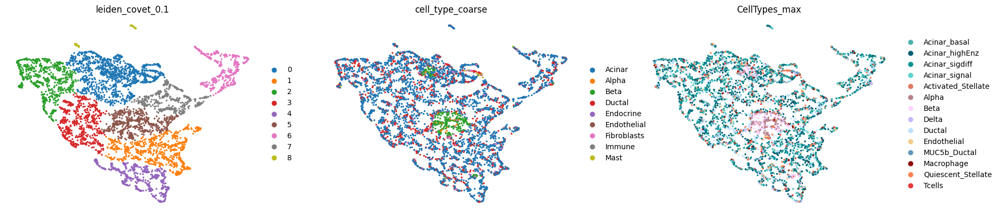

8


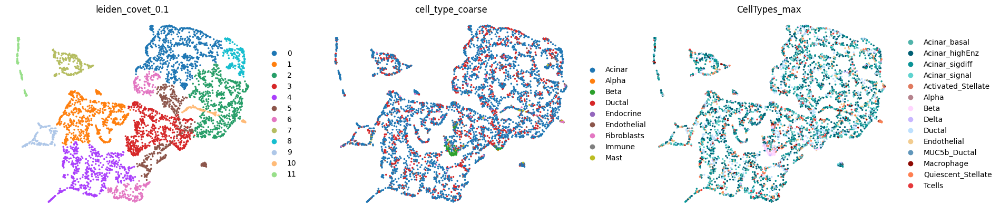

9


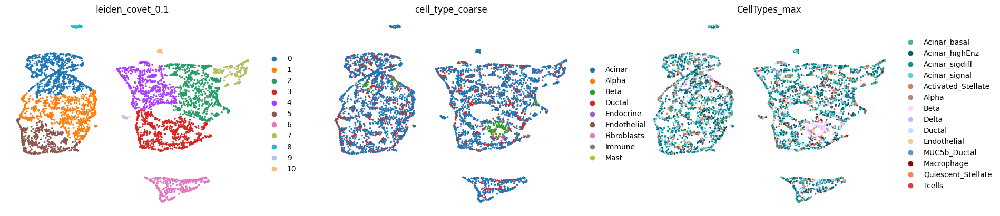

10


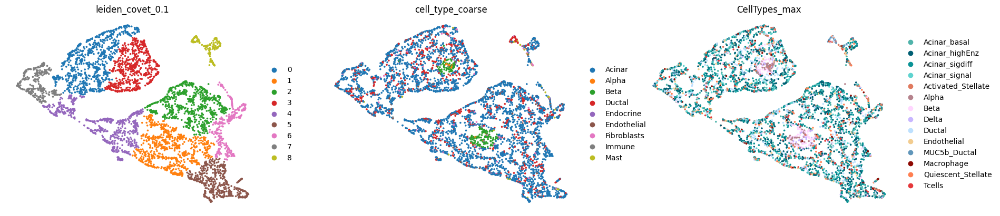

11


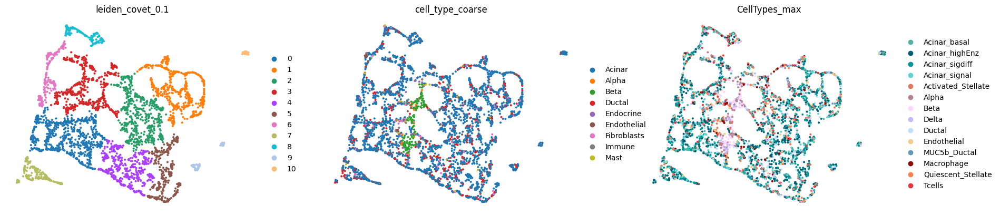

12


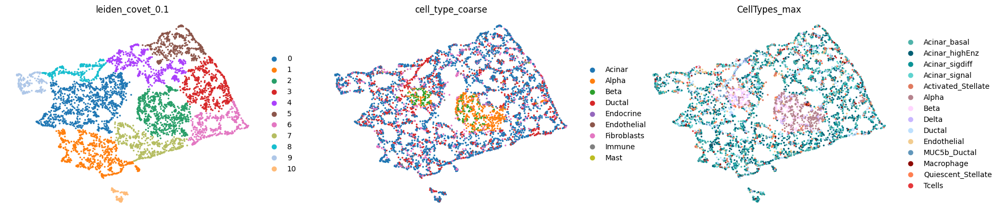

13


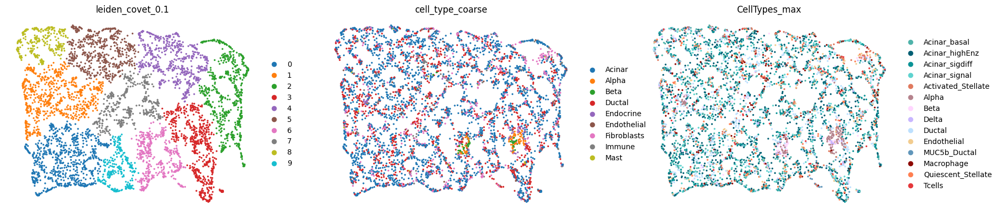

14


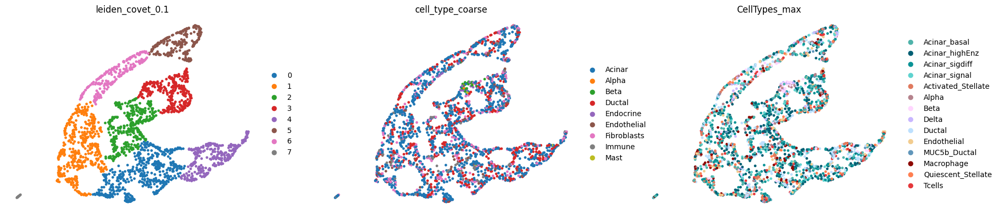

15


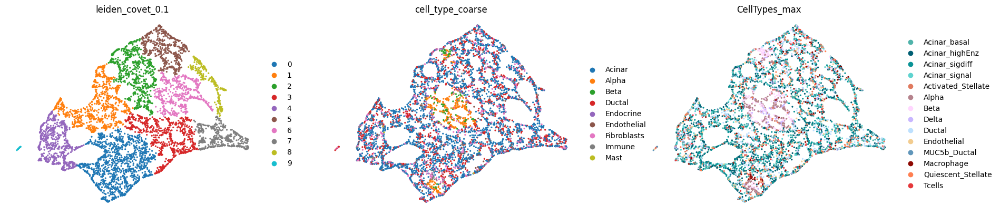

16


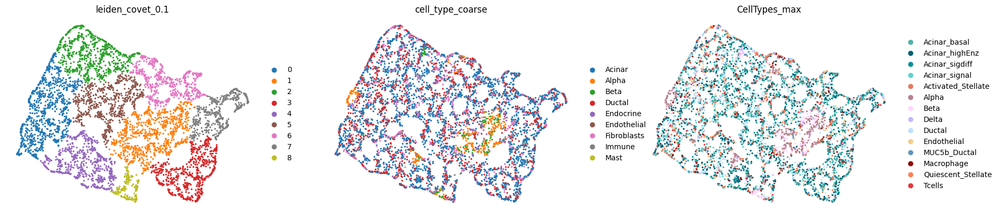

17


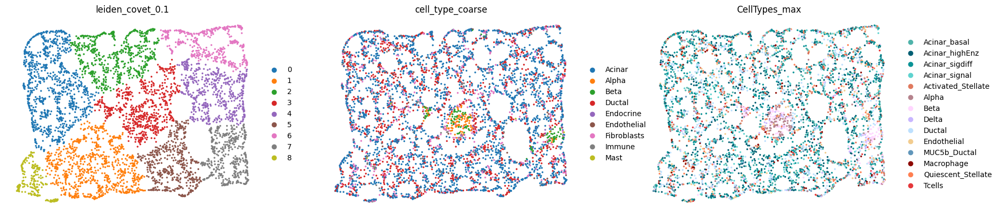

18


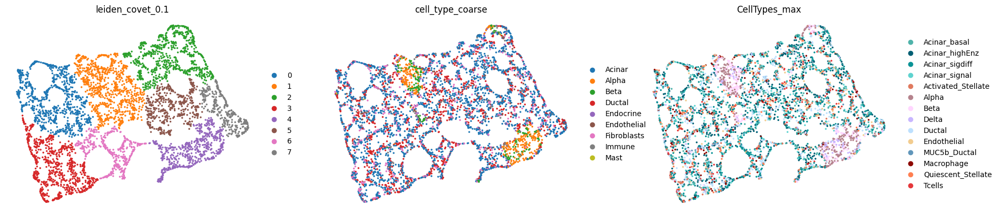

19


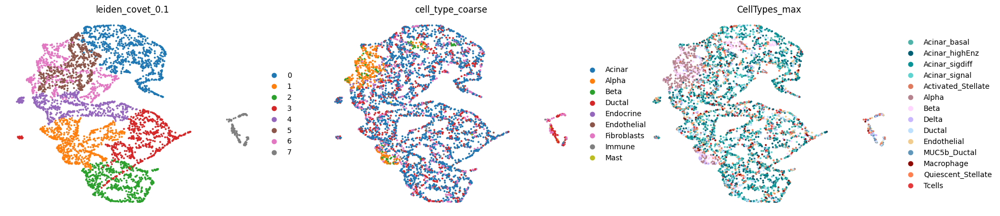

20


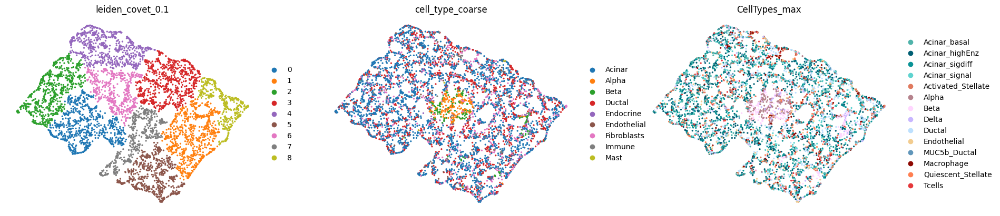

21


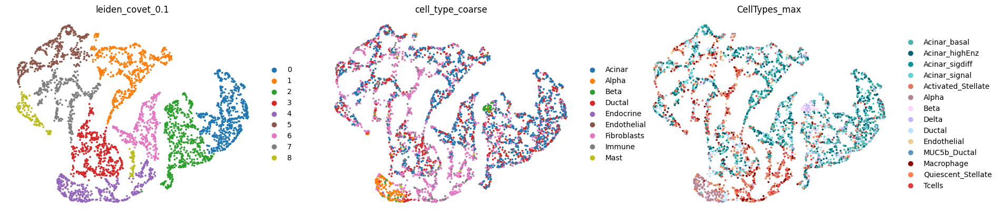

22


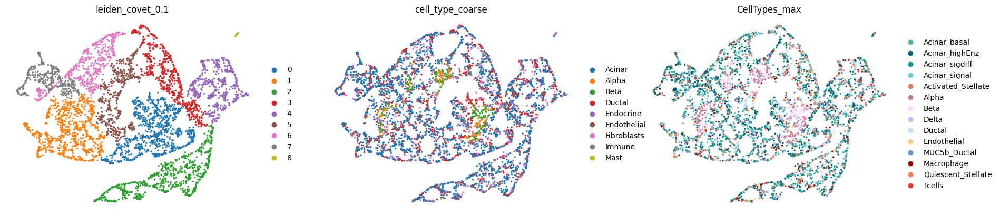

23


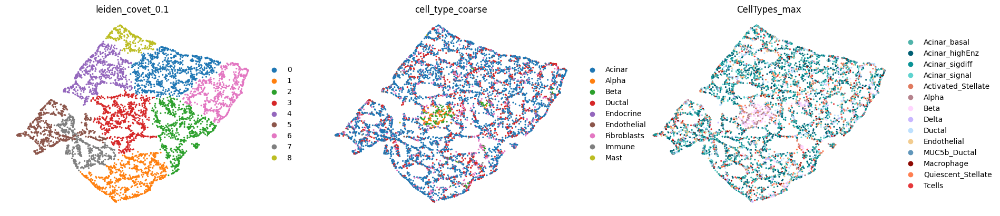

24


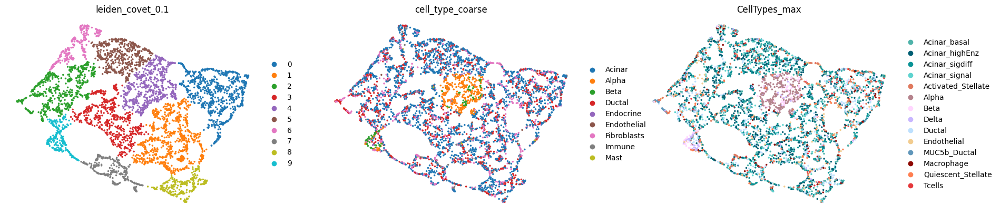

In [17]:
adatas_fov = []
resolution = 0.1
for c in adata.obs.fov.cat.categories:
    adata_fov = adata[np.isin(adata.obs['fov'],[c])].copy()
    print(c)
    sc.tl.umap(adata_fov, min_dist=0.5,neighbors_key="n_neighbors=30")
    sc.tl.leiden(adata_fov, resolution=resolution,
                 key_added='leiden_covet_'+str(resolution),neighbors_key="n_neighbors=30")
    sc.pl.umap(adata_fov, color=['leiden_covet_0.1','cell_type_coarse',"CellTypes_max"],ncols=3,frameon=False)
    adatas_fov.append(adata_fov)       
    del adata_fov
    
adata = ad.concat(adatas_fov, join='outer',uns_merge='same',axis=0,pairwise=True)        

In [18]:
def plot_relative_abundances(adata, group_by, cell_type_key, **kwargs) -> Axes:

    # Step 1: Group observations by 'condition' and count each 'CellTypes_max' entry
    counts = adata.obs.groupby([group_by, cell_type_key]).size().unstack(fill_value=0)
    
    # Step 2: Calculate relative abundance (proportion) by normalizing counts within each condition
    relative_abundance = counts.div(counts.sum(axis=1), axis=0)
    
    #colors 
    colors = ['#4FB3AA',#'Acinar_basal'
              '#005F73',#'Acinar_highEnz', 
              '#0A9396',#'Acinar_sigdiff', 
              '#5FD3CF',#'Acinar_signal',
              '#e07a5f',#'Activated_Stellate', 
              '#b5838d',#'Alpha', 
              #'#f8ad9d',#'Bcells', 
              '#ffd6ff',#'Beta', 
              '#c8b6ff',#'Delta', 
              '#bde0fe',#'Ductal',
              '#f2cc8f',#'Endothelial', 
              #'#ffa62b',#'LymphEndo', 
              '#6096ba',#'MUC5b_Ductal', 
              '#8d0801',#'Macrophage', 
              #'#4f000b',#'Mast',
              '#ff7f51',#'Quiescent_Stellate', 
              #'#ce4257',#'Schwann', 
              '#e5383b',#'Tcells'
    ]
    
    # Plot a stacked bar chart
    ax = relative_abundance.plot(kind='bar', stacked=True,color=colors)
    
    # Customize the plot (labels, title, etc.)
    plt.xlabel('niche')
    plt.ylabel('Relative abundance')
    #plt.title('Stacked Bar Plot of Counts per Category')
    plt.xticks(rotation=90)
    # Step 3: Position the legend outside the plot
    plt.legend(title='Cell types', bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Adjust layout to make room for the legend
    plt.tight_layout()
      
    # Show the plot
    plt.show()

    return ax

In [28]:
def define_niches(adata, group_by, cell_type_key):
    
    # Step 1: Group observations by 'condition' and count each 'CellTypes_max' entry
    counts = adata.obs.groupby([group_by, cell_type_key]).size().unstack(fill_value=0)
        
    # Step 2: Calculate relative abundance (proportion) by normalizing counts within each condition
    relative_abundance = counts.div(counts.sum(axis=1), axis=0)
    
    # Define conditions
    endocrine_condition = (relative_abundance[['Alpha', 'Beta', 'Delta']].sum(axis=1) >= 0.3)
    endocrine_exocrine_condition = (
        (relative_abundance[['Alpha', 'Beta', 'Delta']].sum(axis=1) >= 0.1) &
        (relative_abundance[['Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal']].sum(axis=1) >= 0.4) &
        (relative_abundance[['Ductal', 'MUC5b_Ductal']].sum(axis=1) >= 0.1)
    )
    ductal_condition = (relative_abundance[['Ductal', 'MUC5b_Ductal']].sum(axis=1) >= 0.2)
    acinar_condition = (relative_abundance[['Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal']].sum(axis=1) >= 0.6)
    
    # Define choices
    choices = [
        'Endocrine niche',
        'Endocrine Exocrine niche',
        'Ductal niche',
        'Acinar niche'
    ]
    
    # Apply conditions with np.select
    relative_abundance['niche'] = np.select(
        [endocrine_condition, endocrine_exocrine_condition, ductal_condition, acinar_condition],
        choices,
        default='Heterogeneous niche'
    )

    # Map 'niche' values from niche_df to a new 'niche' column in adata.obs
    adata.obs['covet_niche'] = adata.obs[group_by].map(relative_abundance['niche'])

    
    return adata

FOV = 1- Condition = Index(['T1D'], dtype='object')


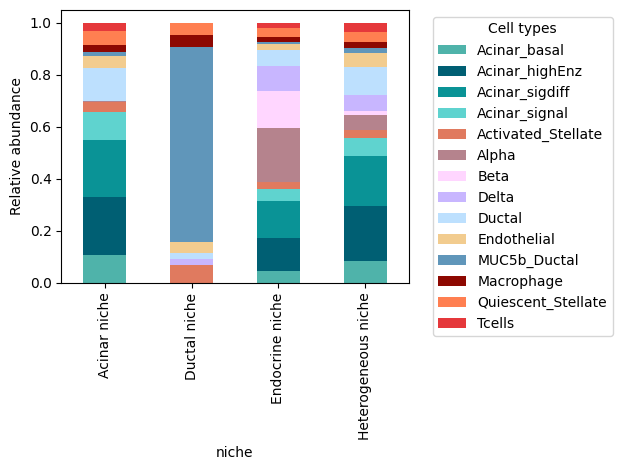

FOV = 2- Condition = Index(['T1D'], dtype='object')


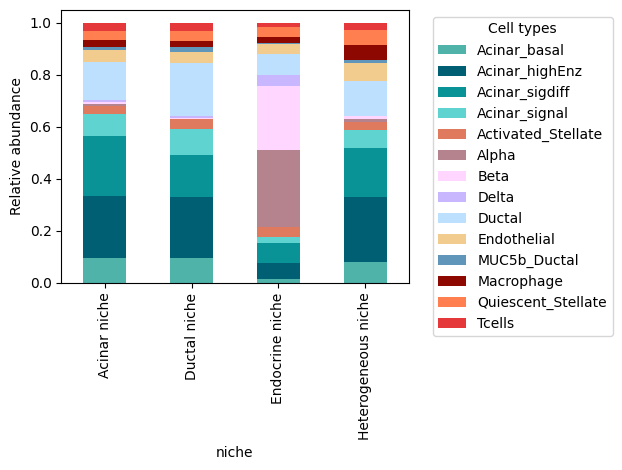

FOV = 3- Condition = Index(['T1D'], dtype='object')


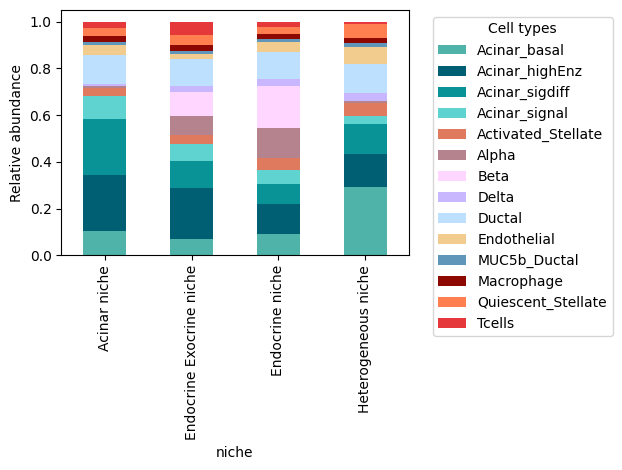

FOV = 4- Condition = Index(['T1D'], dtype='object')


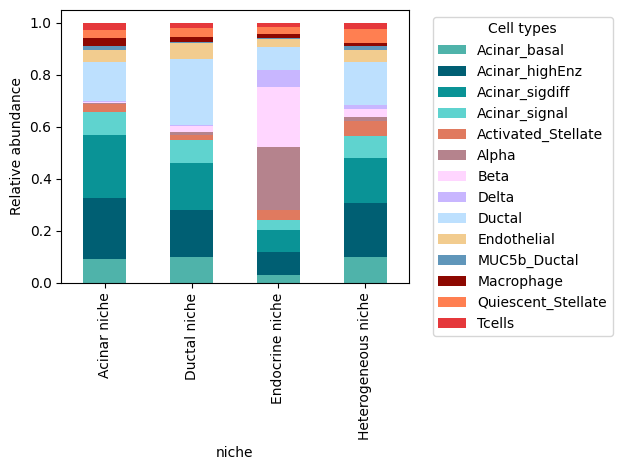

FOV = 5- Condition = Index(['T1D'], dtype='object')


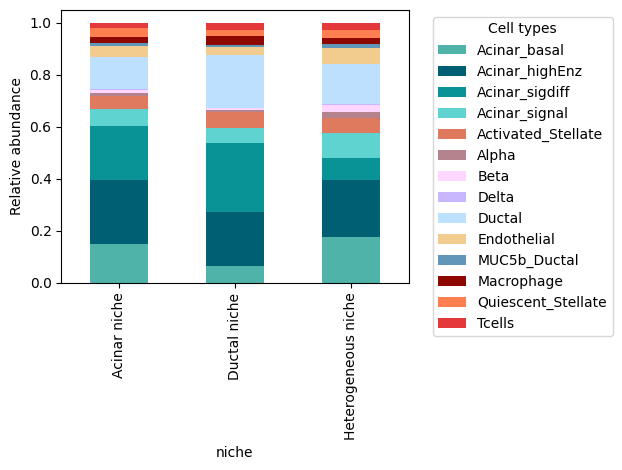

FOV = 6- Condition = Index(['T1D'], dtype='object')


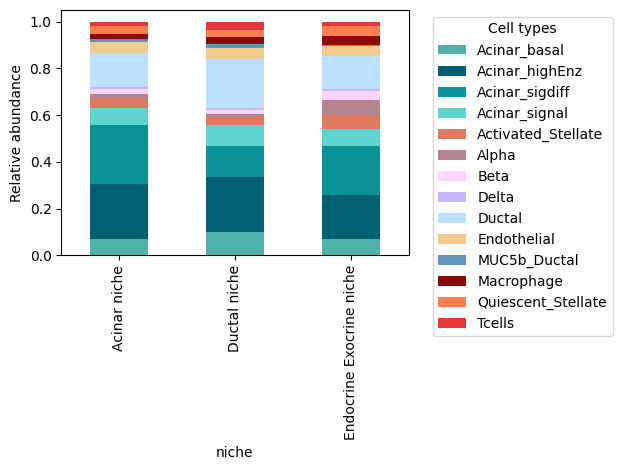

FOV = 7- Condition = Index(['T1D'], dtype='object')


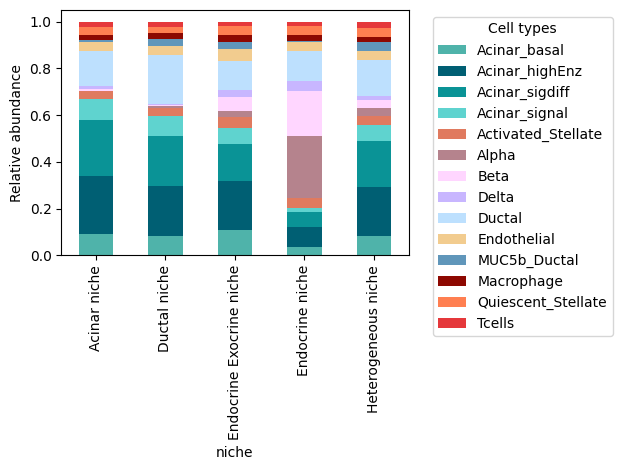

FOV = 8- Condition = Index(['T1D'], dtype='object')


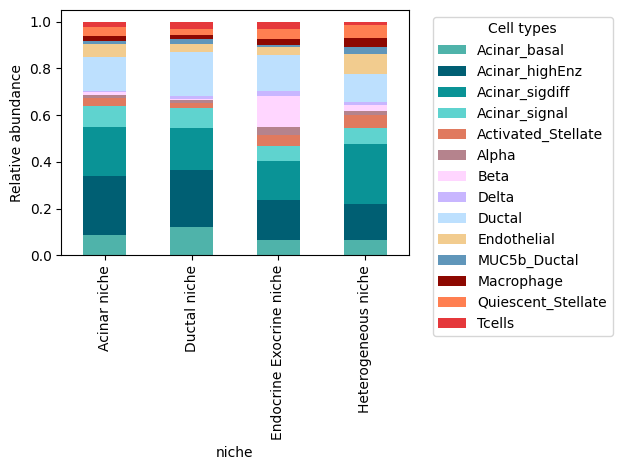

FOV = 9- Condition = Index(['T1D'], dtype='object')


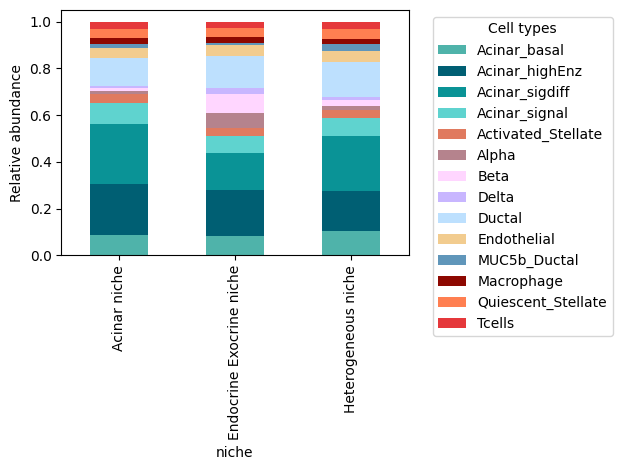

FOV = 10- Condition = Index(['T1D'], dtype='object')


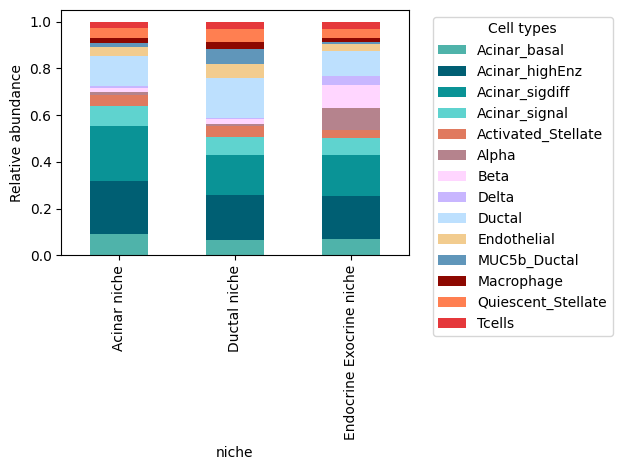

FOV = 11- Condition = Index(['T1D'], dtype='object')


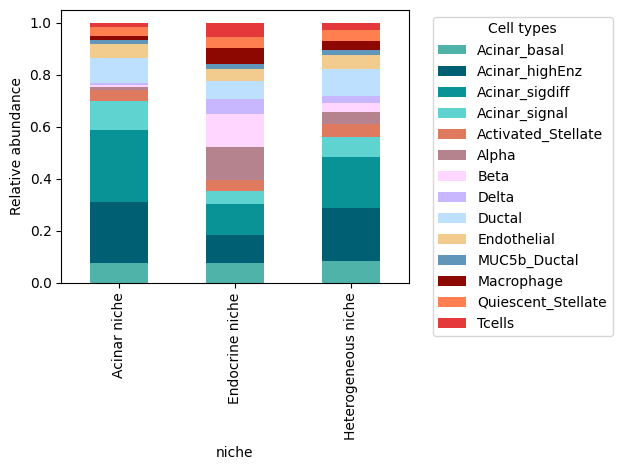

FOV = 12- Condition = Index(['ND'], dtype='object')


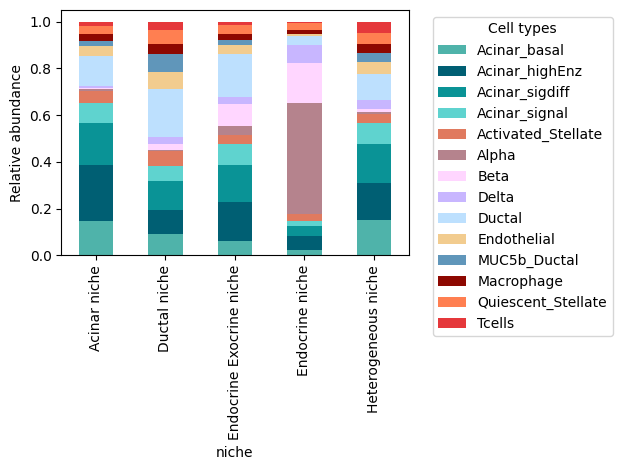

FOV = 13- Condition = Index(['ND'], dtype='object')


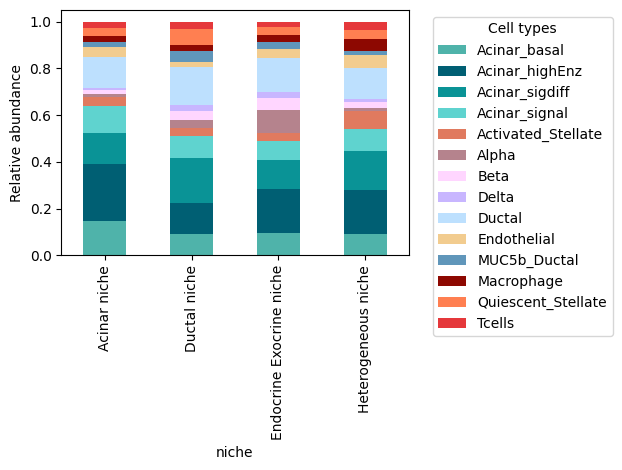

FOV = 14- Condition = Index(['ND'], dtype='object')


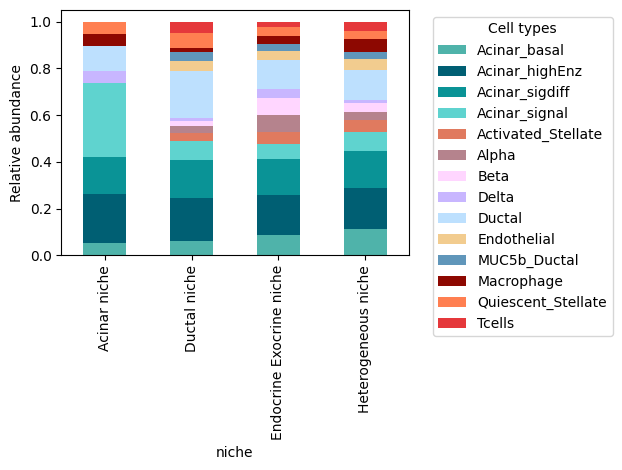

FOV = 15- Condition = Index(['ND'], dtype='object')


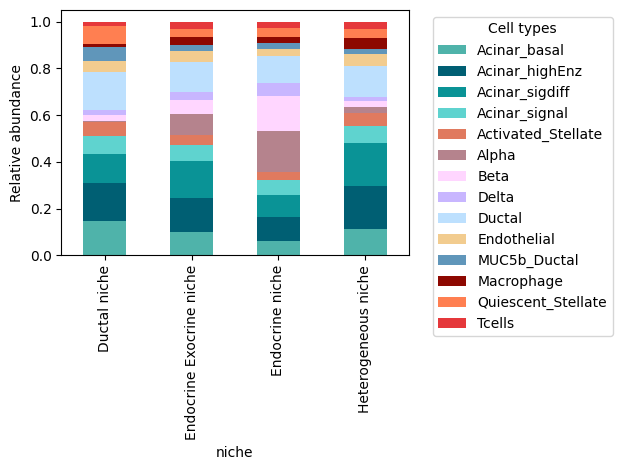

FOV = 16- Condition = Index(['ND'], dtype='object')


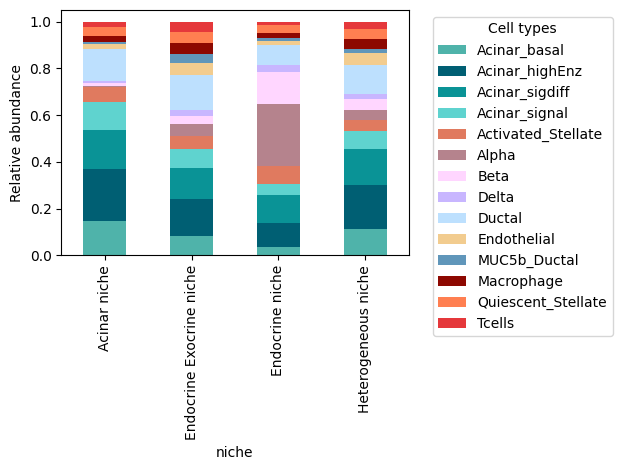

FOV = 17- Condition = Index(['ND'], dtype='object')


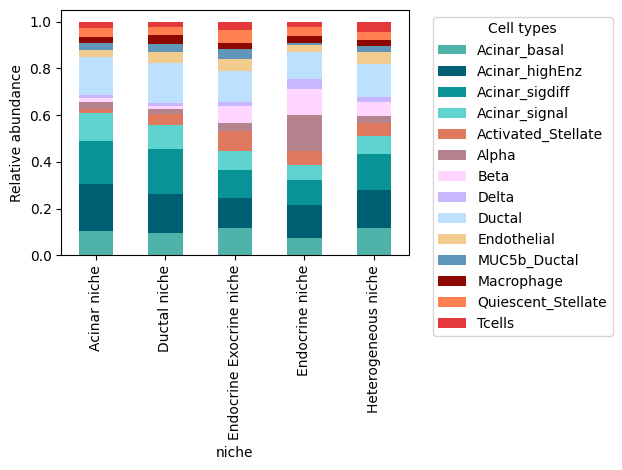

FOV = 18- Condition = Index(['ND'], dtype='object')


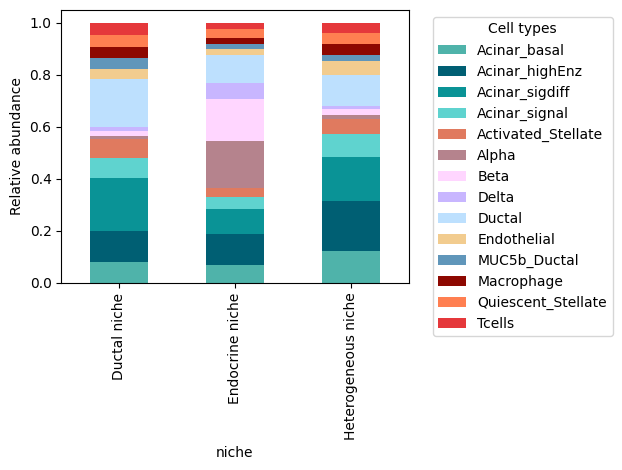

FOV = 19- Condition = Index(['ND'], dtype='object')


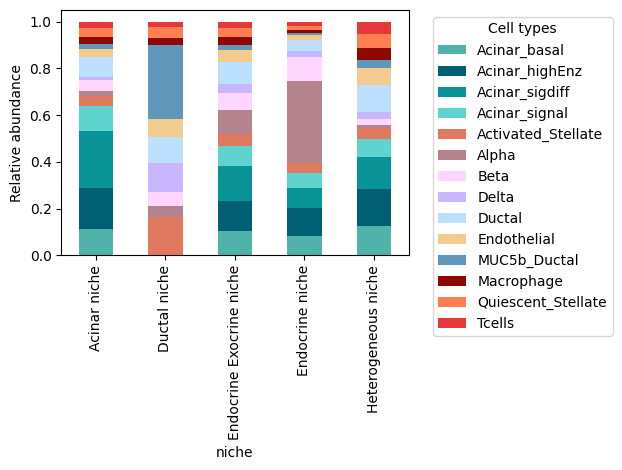

FOV = 20- Condition = Index(['ND'], dtype='object')


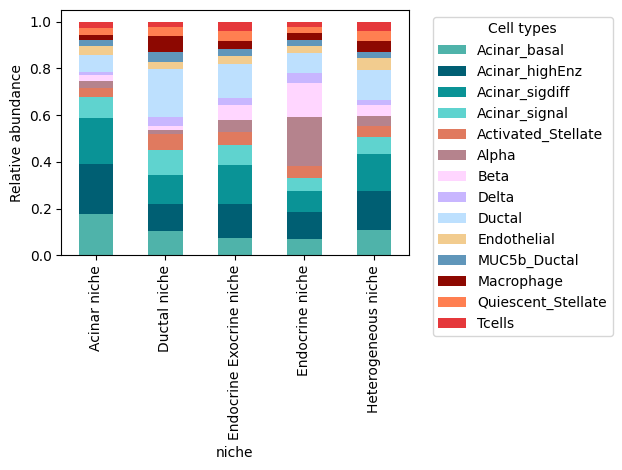

FOV = 21- Condition = Index(['ND'], dtype='object')


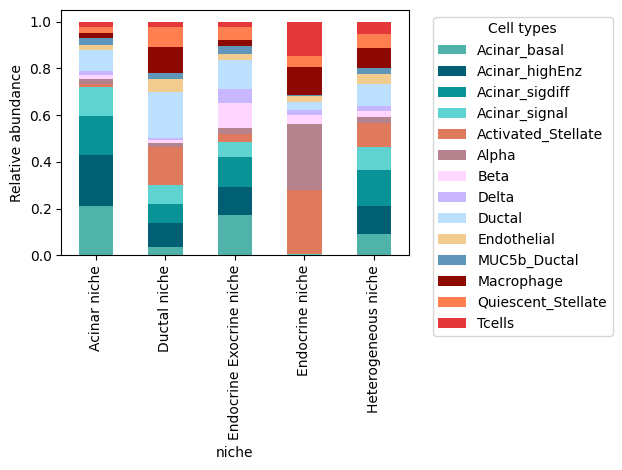

FOV = 22- Condition = Index(['ND'], dtype='object')


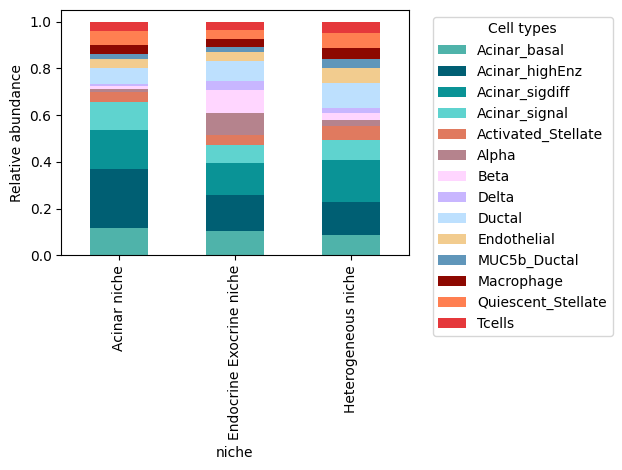

FOV = 23- Condition = Index(['ND'], dtype='object')


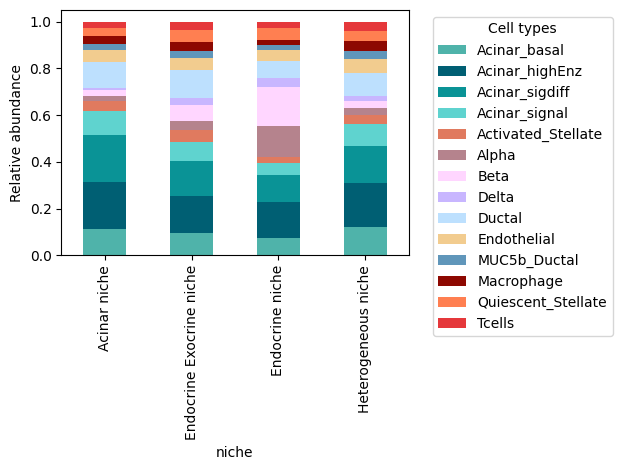

FOV = 24- Condition = Index(['ND'], dtype='object')


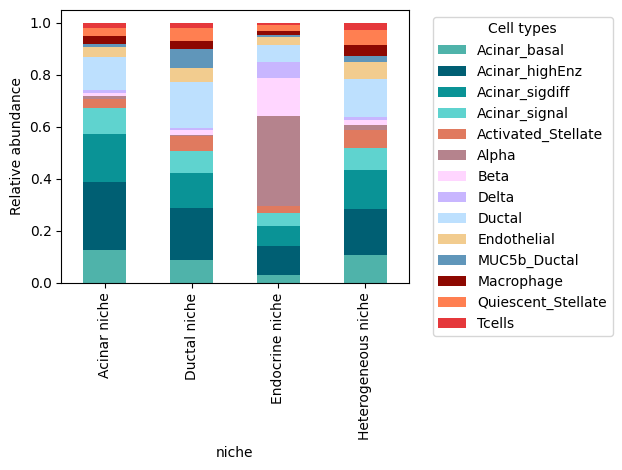

In [29]:
adatas_fov = []
for c in adata.obs.fov.cat.categories:
    adata_fov = adata[np.isin(adata.obs['fov'],[c])].copy()
    define_niches(adata_fov, group_by='leiden_covet_0.1',cell_type_key='CellTypes_max')
    print('FOV = ' + str(c) + '- Condition = ' + str(adata_fov.obs['condition'].cat.categories.unique()))
    plot_relative_abundances(adata_fov, group_by='covet_niche',cell_type_key='CellTypes_max')
    adatas_fov.append(adata_fov)       
    del adata_fov
adata = ad.concat(adatas_fov, join='outer',uns_merge='same',axis=0,pairwise=True)   

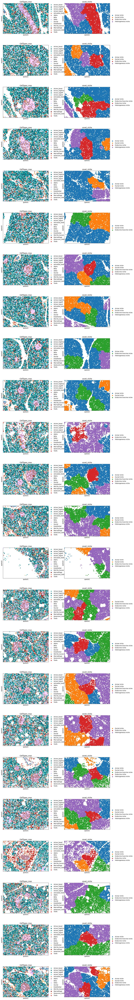

In [30]:
sq.pl.spatial_segment(adata,color=['CellTypes_max','covet_niche'],#library_id=['12'],
                      library_key='fov', seg_cell_id='cell_ID', img=False,ncols=2)

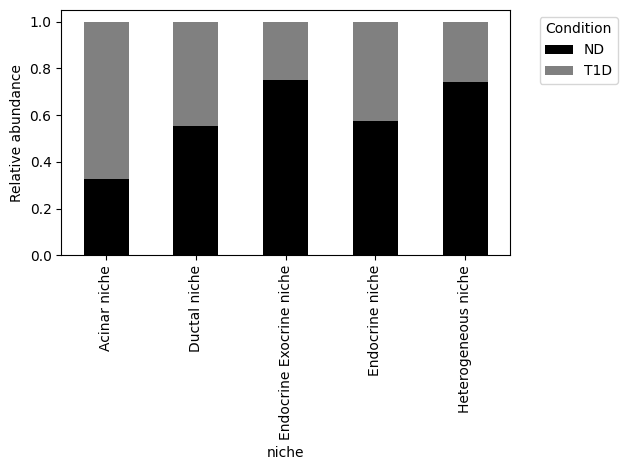

In [31]:
# Step 1: Group observations by 'condition' and count each 'CellTypes_max' entry
counts = adata.obs.groupby(['covet_niche', 'condition']).size().unstack(fill_value=0)
    
# Step 2: Calculate relative abundance (proportion) by normalizing counts within each condition
relative_abundance = counts.div(counts.sum(axis=1), axis=0)
    
#colors 
colors = [
    '#000000',
    '#808080'
]
    
# Plot a stacked bar chart
ax = relative_abundance.plot(kind='bar', stacked=True,color=colors)
    
# Customize the plot (labels, title, etc.)
plt.xlabel('niche')
plt.ylabel('Relative abundance')
#plt.title('Stacked Bar Plot of Counts per Category')
plt.xticks(rotation=90)
# Step 3: Position the legend outside the plot
plt.legend(title='Condition', bbox_to_anchor=(1.05, 1), loc='upper left')
    
# Adjust layout to make room for the legend
plt.tight_layout()
      
# Show the plot
plt.show()

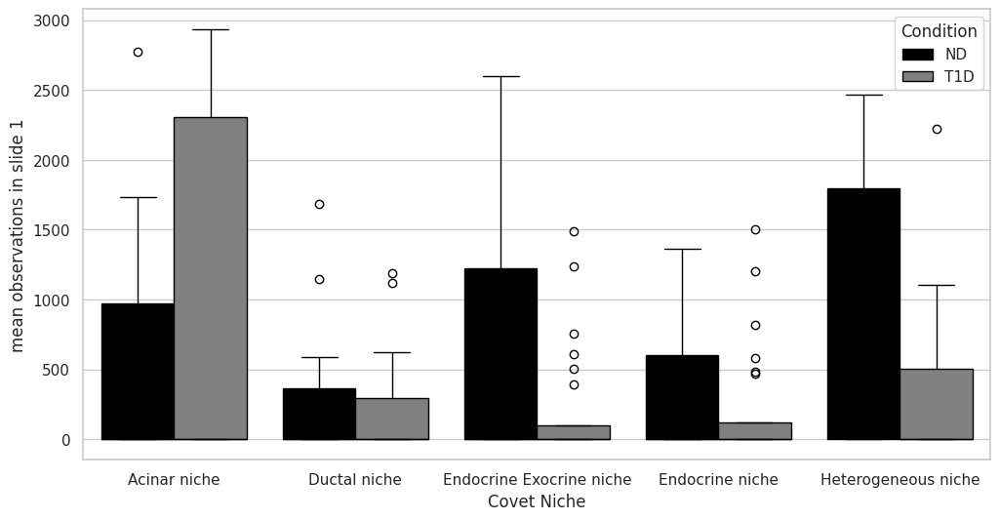

In [55]:
count_df = adata.obs.groupby(['condition', 'covet_niche', 'fov']).size().reset_index(name='count')

# Step 3: Normalize counts from 0 to 1 by group
count_df['normalized_count'] = count_df.groupby(['condition', 'covet_niche'])['count'].transform(lambda x: x / x.sum())

#colors 
colors = {
    'T1D': '#808080',
    'ND': '#000000',
}

# Step 4: Create a box plot
plt.figure(figsize=(12, 6))
sns.boxplot(data=count_df, x='covet_niche', y='count', hue='condition', palette=colors)

plt.ylabel('mean observations in slide 1')
plt.xlabel('Covet Niche')
plt.legend(title='Condition')
plt.show()

In [57]:
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [59]:
# Step 1: Extract conditions and cell types
conditions = adata.obs['condition']
cell_types = adata.obs['covet_niche']

# Step 2: Calculate counts for each condition
counts = adata.obs.groupby(['condition', 'covet_niche']).size().unstack(fill_value=0)

# Split counts by conditions
condition1 = counts.loc['ND']  # Replace with your actual condition names
condition2 = counts.loc['T1D']

# Step 3: Perform Fisher’s exact test
fisher_results = pd.DataFrame(index=counts.columns, columns=['odds_ratio', 'p_value'])

for cell_type in counts.columns:
    # Create a 2x2 contingency table
    table = [
        [condition1[cell_type], condition2[cell_type]],  # Present in condition1 vs condition2
        [condition1.sum() - condition1[cell_type], condition2.sum() - condition2[cell_type]]  # Not present
    ]
    
    # Perform Fisher's exact test
    odds_ratio, p_value = stats.fisher_exact(table)
    fisher_results.loc[cell_type] = [odds_ratio, p_value]

print(fisher_results)

                         odds_ratio   p_value
covet_niche                                  
Acinar niche               0.217222       0.0
Ductal niche               0.953403  0.021962
Endocrine Exocrine niche    2.73993       0.0
Endocrine niche            1.047681  0.017779
Heterogeneous niche        2.900568       0.0


### Interpretation of the Odds Ratio:

- Odds Ratio > 1: The cell type is more likely to occur in Condition 1 (ND) compared to Condition 2 (T1D).

- Odds Ratio = 1: The cell type is equally likely to occur in both conditions. There is no association between the cell type and the condition.
  
- Odds Ratio < 1:The cell type is less likely to occur in Condition 1 (ND) compared to Condition 2 (T1D).
